<a href="https://colab.research.google.com/github/RaphaelGervillie/Superpixel/blob/master/TP2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# TP2



# 1.Présentation des fonctions.

### Imports

In [ ]:
import numpy as np
import datetime, os
from tensorflow.keras.utils import get_file
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import Input
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Activation, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D
from tensorflow.keras.losses import SparseCategoricalCrossentropy, CategoricalCrossentropy
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from tensorflow.keras.models import load_model
from sklearn.metrics import balanced_accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import time
from scipy.signal import savgol_filter
data_f = get_file('data.zip', 'https://github.com/gaudel/NN/raw/main/data.zip', extract=True)

!wget https://github.com/gaudel/NN/raw/main/pretrained_model.h5

11804672/11796941 [==============================] - 0s 0us/step
--2020-11-17 11:32:11--  https://github.com/gaudel/NN/raw/main/pretrained_model.h5
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/gaudel/NN/main/pretrained_model.h5 [following]
--2020-11-17 11:32:11--  https://raw.githubusercontent.com/gaudel/NN/main/pretrained_model.h5
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1033312 (1009K) [application/octet-stream]
Saving to: ‘pretrained_model.h5’

pretrained_model.h5 100%[===================>]   1009K  --.-KB/s    in 0.03s   

2020-11-17 11:32:11 (32.8 MB/s) - ‘pretrained_model.h5’ save

### Fonction importantes.

In [ ]:
def build_CNN_from_pretrained(file_name,output_dim,layer_pop,lr=0.001):
  """ Cette fonction permet de charger un modèle déjà entrainé et de le renvoyer avec la 
  ou les deux dernieres couches en moins. 

  * file_name : le chemin vers le mdèle pré-entrainé. Par défaut "pretrained_model.h5".
  * output_dim : Le nombre de classe à prédire. Ici on veut prédire uniquement des chiens et chats donc =2.
  * layer_pop : Le nombre de layer à supprimer puis rajouter. N'a que deux options, 1 ou 2.
  * lr : la learning rate
  """

  if layer_pop==1:
    model3 = load_model(file_name)
    # on supprime la derniere couche Dense(10)
    model3.pop()
    # On ajoute une novelle couche fully connected avec cette fois deux outputs.
    model3.add(Dense(output_dim))

  if layer_pop==2:
    model3 = load_model(file_name)
    # on supprime la derniere couche Dense(10)
    model3.pop()
    # On doit également supprimer dropout.
    model3.pop()
    # on supprime l'avant derniere couche Dense(64)
    model3.pop()
    
    # On ajoute exactement les mêmes couches et dropout pour les ré-entrainer.
    model3.add(Dense(64, activation="relu"))
    model3.add(Dropout(rate=0.3))
    model3.add(Dense(output_dim))
  

  model3.compile(loss=CategoricalCrossentropy(from_logits=True), optimizer=RMSprop(learning_rate=lr), metrics=['accuracy'])
  return model3

def model_perf(model1,history):  
  """ Cette fonction permet d'obtenir l'accuracy du modèle sur l'échantillon de train et de validation. 
  On affiche également les valeurs de la loss qui nous indique de combien notre prédiction est proche de la vrai valeure. 

  * model1 : Le modèle que l'on vient d'entrainer.
  * history : l'endroit ou le modèle stock les résultats sur l'accuracy du modèle et la loss. 
  """


  print("Train Accuracy :",model1.evaluate_generator(train_flow,20)[1])
  print("Validation Accuracy :",model1.evaluate_generator(valid_flow,20)[1])

  plt.plot(history.history['loss'], label='train')
  plt.plot(history.history['val_loss'], label='test')
  plt.legend()
  plt.title('Test and training Loss')
  plt.show()

def build_CNN(input_dim, output_dim, lr=0.001,dropout=True):
  """
  Cette fonction permet de construire un modèle convolutionnel. 
  Il est composé de plusieurs couches convolutionnelles, de plusieurs couche de maxpooling. 
  On a également précisé Dropout
  input_dim : (32,32,3) le format de l'image
  output_dim : 2 le nombre de classe qu'on veut classifier.
  """


  model = Sequential()

  model.add(Conv2D(32, (3, 3), input_shape=input_dim, activation="relu"))
  model.add(MaxPooling2D(pool_size=(2,2)))
  if dropout==True:
    model.add(Dropout(rate=0.1))

  model.add(Conv2D(64, (3, 3), activation="relu"))
  model.add(MaxPooling2D(pool_size=(2,2)))
  if dropout==True:
    model.add(Dropout(rate=0.1))

  model.add(Conv2D(64, (3, 3), activation="relu"))
  model.add(MaxPooling2D(pool_size=(2,2)))
  if dropout==True:
    model.add(Dropout(rate=0.1))

  model.add(Flatten())
  model.add(Dense(64, activation="relu"))
  if dropout==True:
    model.add(Dropout(rate=0.3))

  model.add(Dense(output_dim))


  model.compile(loss=CategoricalCrossentropy(from_logits=True), optimizer=RMSprop(learning_rate=lr), metrics=['accuracy'])

  return model

### Fonction graphique

In [ ]:
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip( images_arr, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()



def plotImageDataGenerator(image_int,rotation_range=0,width_shift_range=0.0,
                           height_shift_range=0.0,zoom_range=0.0,horizontal_flip=False,
                           vertical_flip=False):
  
  image_generator = ImageDataGenerator(rescale=1./255,
                                       rotation_range=rotation_range,
                                       width_shift_range=width_shift_range,
                                       height_shift_range=height_shift_range,
                                       zoom_range=zoom_range,
                                       horizontal_flip=horizontal_flip,
                                       vertical_flip=vertical_flip)
  train_data_gen = image_generator.flow_from_directory(batch_size=20,directory=data_f[:-4] + '/' + "train",shuffle=True)
  augmented_images = [train_data_gen[0][0][0] for i in range(image_int)]
  plotImages(augmented_images)


def foo(data_src):
  if type(data_src) == str:
    images, labels = next(ImageDataGenerator(rescale=1./255).flow_from_directory(data_f[:-4] + '/' + data_src, batch_size=6))
  else:
    images, labels = next(data_src)

  print(f'shape of features: {images.shape[1:]}')
  print(f'shape of labels: {labels.shape[1:]}')
  class_names = ['cat', 'dog']
  plt.figure(figsize=(10,10))
  for i in range(6):
      plt.subplot(3,3,i+1)
      plt.xticks([])
      plt.yticks([])
      plt.grid(False)
      plt.imshow(images[i], cmap=plt.cm.binary)
      plt.xlabel(class_names[np.argmax(labels[i])] + f' ({labels[i]})')
  plt.show()


# 2.Questions de Cours. 

### Couche convolutionnelle

Nous disposons d'images en 3 dimensions 32x32x3 (hauteur x largeur x profondeur RGB). La profondeur correspond aux intensités de rouge, vert et de bleu nécessaire pour former la couleur du pixel. Pour notre travail, les images sont en fait des matrices de taile 32x32 où chacun des éléments de la matrice est un vecteur contenant trois valeurs d'intensité de couleurs rouge, vert et bleu.

On introduit une image de dimension 32x32x3 (RGB) dans le réseau de neuronne. On commence ensuite par créer une première couche de convolution (convolution layer) en appliquant 32 **filtres** (noyaux ou kernels). L'application d'un filtre correspond à la création d'une matrice appelée **matrice de convolution** qui contient différents poids. Son application engendre la création d'une **carte caractéristique** (feature map / activation map) comme vous pouvez le voir ci-dessous.



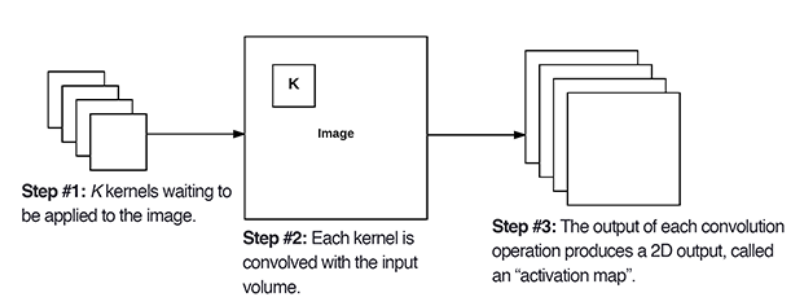


Chacun de ces 32 filtres vont analyser l'image initiale en se déplaçant en fonction d'un pas (stride) que nous poserons égal à 1 par défaut. Ici nos filtres (noyaux) utilisés sont de dimensions 3x3 donc chaque partie de l'image qu'on analyse correspond à 9 pixels comme vous pouvez le voir sur l'image ci-dessous. 








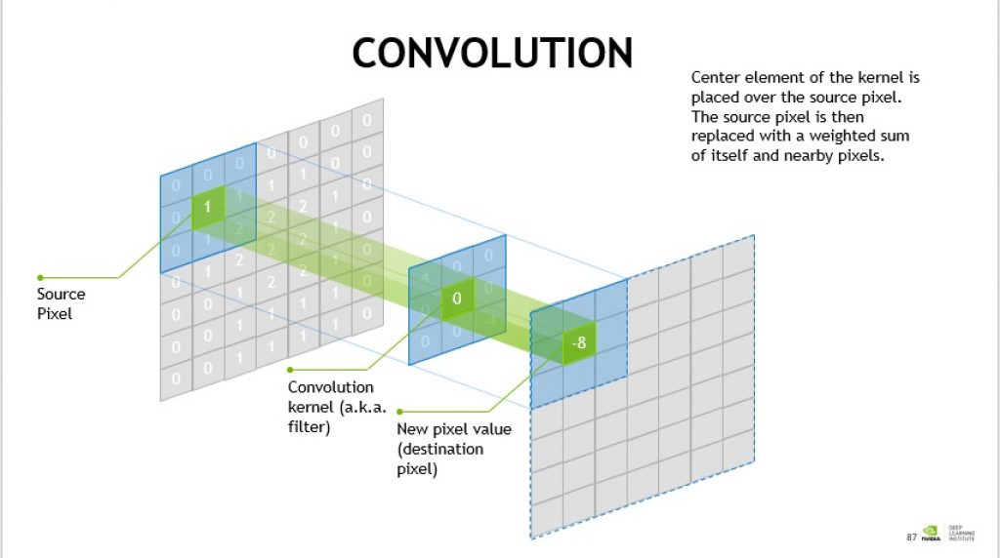

Il faut toutefois rappeler qu'un pixel est rattaché à un vecteur de trois valeurs correspondant aux intensités de rouge, vert et bleu. Nous pouvons donc visualiser les noyaux comme des tenseurs de dimensions 3x3x3 (RGB) utilisés sur chaque parties de l'image. 

Notre couche de convolution sera en 3 dimensions et aura une profondeur qui vaut 32, car lorsque nous appliquerons une **convolution** sur l'image (qui correspond au faite déplacer le filtre sur l'ensemble de l'image), il en ressortira 1 **carte de caractéristiques** (ou feature map). Sur l'image ci-dessous (source: Wikipédia) vous pouvez voir la profondeur de la couche de convolution (en bleu) représentée par le nombre de neuronnes (ronds bleus) utilisés pour analyser une seule et même partie de l'image (rectangle rouge) par le biais d'un noyau différent pour chaque neuronne.

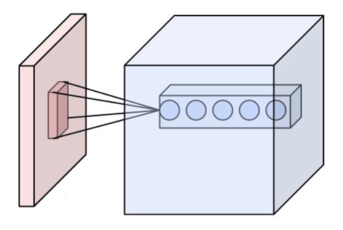

### Fonction d'activation 


Lors de chaque couche de convolution, nous appliquons la fonction d'activation "**ReLu**" utilisée après filtrage. Cette fonction va faire en sorte de retenir seulement les valeurs positives de la moyenne pondérée des pixels obtenue lors du filtrage. Il s'agît d'une transformation non-linéaire. Ci-dessous se trouve l'allure de la fonction "ReLU".



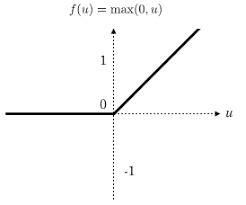

### Max Pooling

Ensuite, après chaque couche de convolution et après avoir appliqué la fonction d'activation, nous ajoutons une couche de pooling, et plus précisément de **max-pooling** de taille 2x2. La couche de pooling va s'appliquer sur chaque carte caractéristique et va permettre de diminuer leur taille en prenant la valeur maximale des pixels au sein du carré 2x2. Ce max-pooling de taille 2x2 va se déplacer avec un pas/stride égal à 2 (par défaut va prendre la taille du pool). On va ainsi diminuer la taille de chaque dimensions des cartes caractéristiques par 2 (exemple: va passer de dimension 30x30 à 15x15). Il faut noter que la phase de pooling n'est pas une phase d'apprentissage pour le réseau de neuronne au sens où il n'a besoin d'estimer aucuns paramètres. De plus, le pooling permet au final de détecter plus facilement les objets à l'intérieur de l'image car nous n'allons analyser seulement les parties de l'image ayant le plus d'informations. Plus précisément il va résumer l'information de plusieurs pixels voisins en une seule informaiton. Vous trouverez une illustration du max-pooling ci-dessous.




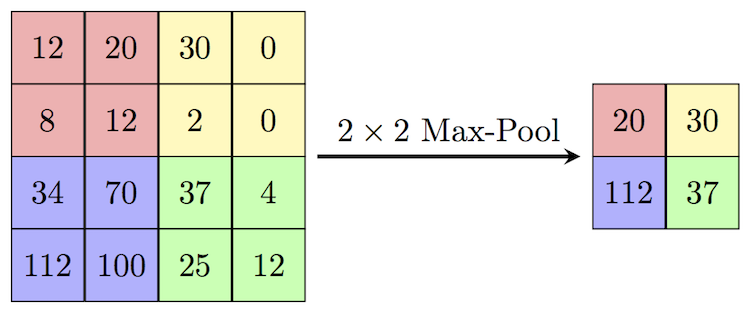

### Dropout


Enfin on applique le **dropout** qui consiste à ignorer certains neuronnes choisis de manière aléatoire. Nous fixons une probabilité d'ignorer le neuronne (que l'on précise dans la variable rate lorsque l'on crée la couche) pour chaque étape de l'apprentissage du réseau de neuronne. Cette phase peut être vue comme une phase de régularisation permettant d'éviter le sur-apprentissage en ignorant volontairement des éléments choisis de manière aléatoire. Voici une illustration ci-dessous avec à gauche un cas sans dropout, et à droite un cas avec dropout.



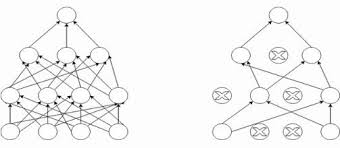

### Flatten


Pour pouvoir classifier notre image il va falloir transformer nos images en vecteurs. C'est le but de la fonction **flatten**.



### batch size. 

Pour des problèmatiques de mémoire, nous utilisons des batch de taille 20 dans le code ci-dessous. En principe, le choix de la taille devrait s'effectuer en fonction du GPU utilisé (et être une puissance de 2). L'idée est d'utiliser une taille assez faible pour améliorer le réseau. Il faut également noter que plus la taille est faible, plus il faudra augmenter le nombre d'epoch pour éviter le sous-apprentissage.

### Padding
On peut remarquer que l'absence de **padding** réduit la dimension de nos cartes caractéristiques par rapport à l'image initiale. En effet, le padding correspond à l'ajout artificiel de lignes et colonnes de zéro pour éviter que nos images ne se réduisent petit à petit. Dans le summary, on voit que nos cartes caractéristiques sont de dimension 30x30 après l'application de 32 filtres sur l'image initiale de dimension 32x32. On observe cette baisse de taille après chaque couche de convolution.

### Definition Transfer Learning. 

### Definition Learning Rate

# 3.Questions

### Q1

In [ ]:
model1=build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001)
model1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 30, 30, 32)        896       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 15, 15, 32)        0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 15, 15, 32)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 13, 13, 64)        18496     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 6, 6, 64)          0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 6, 6, 64)          0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 4, 4, 64)         

#### Nombre de paramètres à estimer


Nous souhaitons maintenant calculer le nombre de paramètres à estimer lors de chaque étape de convolution. Nous avons appliqué une première couche de convolution en utilisant 32 noyaux. Sachant que la profondeur de l'image initiale est de 3 (RVB), appliquer 32 noyaux sur l'image initiale reviendrait donc à appliquer 32 noyaux de dimension 3x3x3. De plus, pour calculer le nombre de paramètres à estimer, il faut prendre en compte que nous ajoutons un paramètre de biais pour chaque filtres.

* conv2D 1ère couche : 9 poids dans le noyau (noyau de taille 3x3) x 32 kernels x 3 (profondeur du noyau) + 32 biais = 896 paramètres à estimer.


Ensuite nous avons appliqué une seconde couche de convolution afin d'obtenir 64 cartes de caractéristiques. Sachant qu'il en est ressorti 32 cartes caractéristiques à la couche précédente, nous allons utiliser 64 noyaux de dimension 3x3x32 (profondeur de la couche de convolution).

* Conv2D 2e couche : 32 kernels x 9 poids dans le noyau x 64 (profondeur du noyau) + 64 biais = 18 496 paramètres.


De même pour la troisième couche de convolution, sachant qu'il en est ressorti 64 cartes caractéristiques lors de la deuxième couche, nous avons utilisé 64 noyaux de dimension 3x3x64.

* Conv2D 3e couche : 64 kernels x 9 poids x 64 (profondeur du noyau) + 64 = 36928 paramètres

Après cette troisième couche de convolution, et après application du dernier max-pooling, nous diposons de 64 cartes caractéristiques de taille 2x2. Nous souhaitons mainteant utiliser les parties d'images que nous avons entrainés afin de faire de la classification pour notre image initiale (dans notres cas présent, choisir si l'image contient un chat ou un chien). Nous appliquons d'abord la fonction Flatten afin de réunir ces informations en un unique vecteur.

* Flatten: 2x2x64 = vecteur de 256 valeurs

Nous créons une couche de 64 neuronnes cachés prenant en compte ces 256 observations.

* Dense_2: 256x64 + 64 = 16 448 paramètres à estimer

Notre but étant de savoir si il y a un chien ou un chat dans notre image, la dernière couche de notre réseau de neuronne comportera deux neuronnes et va prendre en compte les valeurs sortant des 64 neuronnes précédant (ainsi que 2 paramètres de biais).

* Dense_3: 64x2 + 2 = 130 paramètres à estimer
 


### Q2

In [ ]:
train_generator = ImageDataGenerator(rescale=1./255)
valid_generator = ImageDataGenerator(rescale=1./255)
#Q2: Ajouter les attributs "target_size" et "batch_size"
train_flow = train_generator.flow_from_directory(data_f[:-4]+'/train', batch_size=20,target_size=(32, 32))
valid_flow = valid_generator.flow_from_directory(data_f[:-4]+'/valid', batch_size=20,target_size=(32, 32))

Found 2500 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


Found 2500 images belonging to 2 classes.
shape of features: (256, 256, 3)
shape of labels: (2,)


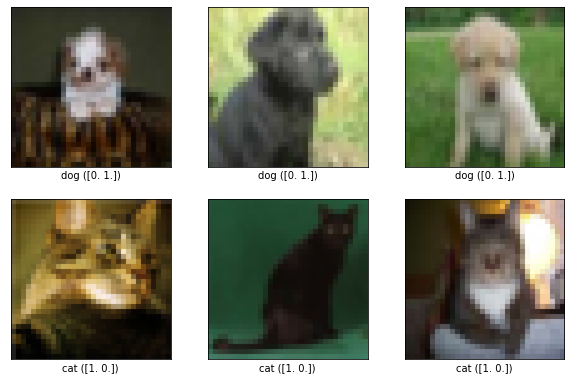

In [ ]:
foo('train')

Epoch 1/20
125/125 [==============================] - 2s 12ms/step - loss: 0.6947 - accuracy: 0.5164 - val_loss: 0.6835 - val_accuracy: 0.5820
Epoch 2/20
125/125 [==============================] - 1s 11ms/step - loss: 0.6692 - accuracy: 0.5960 - val_loss: 0.6483 - val_accuracy: 0.6500
Epoch 3/20
125/125 [==============================] - 1s 11ms/step - loss: 0.6355 - accuracy: 0.6452 - val_loss: 0.6433 - val_accuracy: 0.5940
Epoch 4/20
125/125 [==============================] - 1s 11ms/step - loss: 0.6141 - accuracy: 0.6572 - val_loss: 0.5993 - val_accuracy: 0.6820
Epoch 5/20
125/125 [==============================] - 1s 11ms/step - loss: 0.5869 - accuracy: 0.6884 - val_loss: 0.6033 - val_accuracy: 0.6730
Epoch 6/20
125/125 [==============================] - 1s 11ms/step - loss: 0.5523 - accuracy: 0.7136 - val_loss: 0.6000 - val_accuracy: 0.6810
Epoch 7/20
125/125 [==============================] - 1s 11ms/step - loss: 0.5358 - accuracy: 0.7328 - val_loss: 0.5574 - val_accuracy: 0.7200

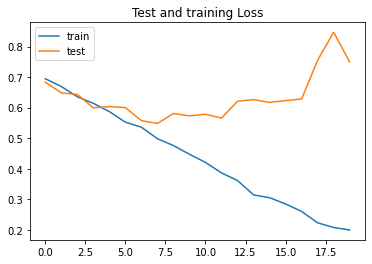

In [ ]:
model1=build_CNN((32, 32, 3),2)


history = model1.fit(train_flow,
                     epochs=20,
                     validation_data=valid_flow,
                     verbose=1)
model_perf(model1,history)

* décalage important entre la loss du train et de la validatio
* on a donc un gros overfitting du modèle. 
* Il faudrait baisser le nombre d'epoch pour eviter ca. 
* On constate néanmoins qu'on réussi à faire un score d'accuracy sur l'ech de validation assez bon (vers 73% de bonne classification)
* On peut mettre un ES pour que le modèle stop après 3 epochs. 

### Q3. 

Found 2500 images belonging to 2 classes.


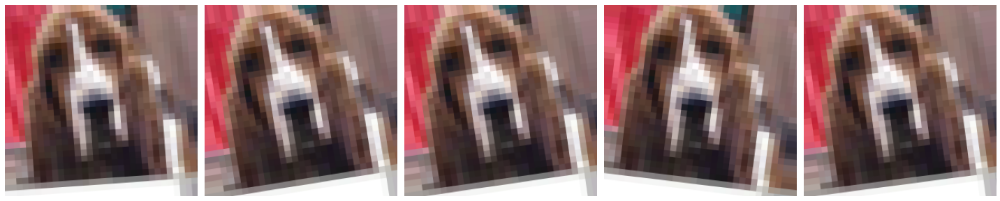

In [ ]:
plotImageDataGenerator(image_int=5,rotation_range=10)

Found 2500 images belonging to 2 classes.


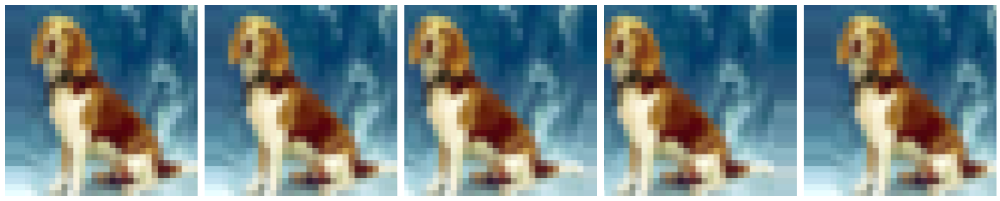

In [ ]:
plotImageDataGenerator(image_int=5,width_shift_range=0.11)

Found 2500 images belonging to 2 classes.


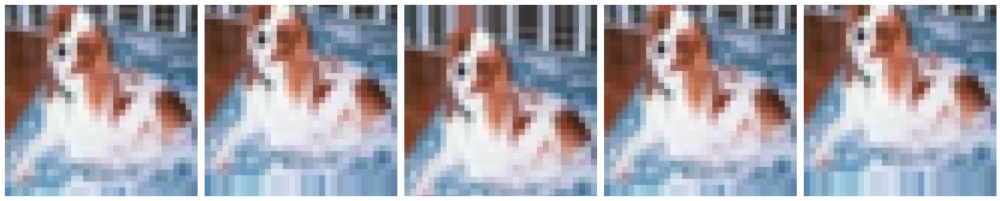

In [ ]:
plotImageDataGenerator(image_int=5,height_shift_range=0.11)

Found 2500 images belonging to 2 classes.


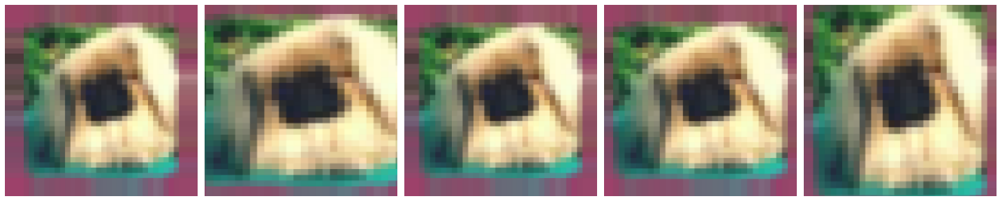

In [ ]:
plotImageDataGenerator(image_int=5,zoom_range=0.2)

Found 2500 images belonging to 2 classes.


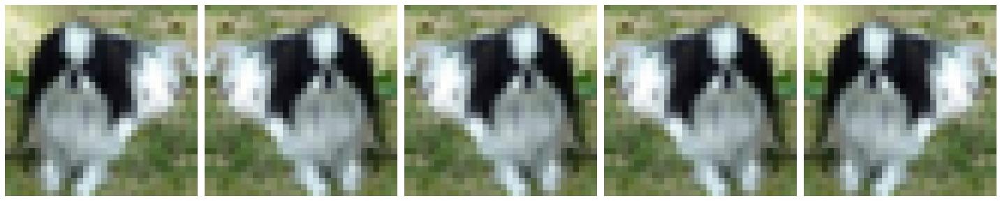

In [ ]:
plotImageDataGenerator(image_int=5,horizontal_flip=True)

Found 2500 images belonging to 2 classes.


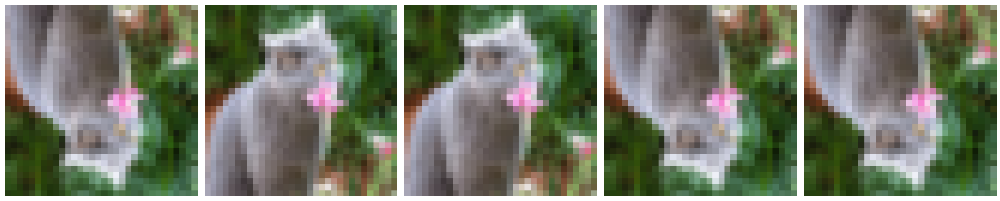

In [ ]:
plotImageDataGenerator(image_int=5,vertical_flip=True)

On met pas vertical flip justifier 
justifier pour les autres
* rotation_range : Très faible pour eviter d'avoir des images de chat ou de chiens inversées et donc faire apprendre au réseau des mauvaises images.
* width_shift_range : très faible pour eviter que la tête du chat ou chien ne sorte du cadre
* height_shift_range : très faible pour eviter que la tête du chat ou chien ne sorte du cadre
* horizontal_flip : L'une des options les plus important selon non. Comme on le voit sur l'image le chien reste un chien si on inverse horizontalement l'image.
* vertical_flip : comme on peut le voir sur cette image cette option n'a pas de sens car cela risque de faire apprendre au réseaux des chats et des chiens inversés et donc biaiser l'apprentissage. 

In [ ]:
train_generator2 = ImageDataGenerator( rescale=1./255,
      rotation_range=11,
      width_shift_range=0.11,
      height_shift_range=0.11,
      zoom_range=0.2,
      horizontal_flip=True,
      vertical_flip=False) # On ne veut pas de flip vertical.

valid_generator2 = ImageDataGenerator(
      rescale=1./255,
      rotation_range=11,
      width_shift_range=0.11,
      height_shift_range=0.11,
      zoom_range=0.2,
      horizontal_flip=True,
      vertical_flip=False) # On ne veut pas de flip vertical.

#Q2: Ajouter les attributs "target_size" et "batch_size"
train_flow2 = train_generator2.flow_from_directory(data_f[:-4]+'/train', batch_size=20,target_size=(32, 32))
valid_flow2 = valid_generator2.flow_from_directory(data_f[:-4]+'/valid', batch_size=20,target_size=(32, 32))

Found 2500 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.


Epoch 1/200
125/125 [==============================] - 3s 25ms/step - loss: 0.6963 - accuracy: 0.5076 - val_loss: 0.6897 - val_accuracy: 0.5780
Epoch 2/200
125/125 [==============================] - 3s 24ms/step - loss: 0.6878 - accuracy: 0.5536 - val_loss: 0.6787 - val_accuracy: 0.5890
Epoch 3/200
125/125 [==============================] - 3s 24ms/step - loss: 0.6796 - accuracy: 0.5748 - val_loss: 0.6712 - val_accuracy: 0.5820
Epoch 4/200
125/125 [==============================] - 3s 24ms/step - loss: 0.6568 - accuracy: 0.6104 - val_loss: 0.6628 - val_accuracy: 0.5760
Epoch 5/200
125/125 [==============================] - 3s 24ms/step - loss: 0.6532 - accuracy: 0.6180 - val_loss: 0.6406 - val_accuracy: 0.6500
Epoch 6/200
125/125 [==============================] - 3s 24ms/step - loss: 0.6497 - accuracy: 0.6220 - val_loss: 0.6359 - val_accuracy: 0.6420
Epoch 7/200
125/125 [==============================] - 3s 24ms/step - loss: 0.6356 - accuracy: 0.6368 - val_loss: 0.6211 - val_accuracy:

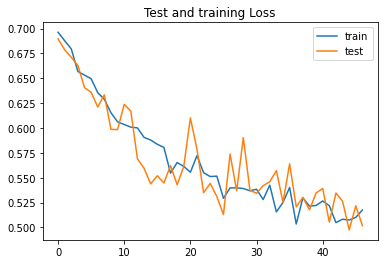

In [ ]:
model2 = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001)
es = EarlyStopping(monitor='loss', mode='min', verbose=0, patience=10)
history2=model2.fit(
      train_flow2,
      epochs=200,
      validation_data=valid_flow2,callbacks=[es],
      verbose=1)
model_perf(model2,history2)

* On voit que le train et le test sont beaucoup plus proche. 
* Les résultats concernant l'accuracy et la loss sont également plus proche.
* On en conclue donc que la Data augmentation a permis de réduire l'overfitting.
* On voit également que le nombre d'epoch est plus important 47, ce qui indique que le modèle a besoin de plus d'epoch pour pouvoir etre entrainé. On l'expique par le fait que les données ont étaient augmentées artificiellement rendant l'entrainement plus long.
* On voit enfin que le score de validation Accuracy est meilleur qu'avec le modele sans data augmentation.
* On remarque quand même que 80 epochs semble trop important, même avec la data augmentation, en effet on voit que vers la fin la training loss continue de descendre mais la test loss commence à stagner ce qui est un des signes de l'overfitting. 

### Q4. 

* Supprime la derniere couche pour l'entrainer sur 2 classes uniquement 
* Utiliser le réseaux déjà entrainer afin de ne pas avoir à réentrainer tout un 
modèle. 
* Baisse la Lr et augmenter pour voir impact. Regarder temps de calcul time.time, comparer perfs.

In [ ]:
cnn_model = model3=build_CNN_from_pretrained("pretrained_model.h5",output_dim=2,layer_pop=1,lr=learn_rate)
cnn_model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_15 (Conv2D)           (None, 30, 30, 32)        896       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 15, 15, 32)        0         
_________________________________________________________________
dropout_20 (Dropout)         (None, 15, 15, 32)        0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 13, 13, 64)        18496     
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 6, 6, 64)          0         
_________________________________________________________________
dropout_21 (Dropout)         (None, 6, 6, 64)          0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 4, 4, 64)         

In [ ]:
 # On entraine un modèle en modifiant uniquement la derniere couche.
 train=False

 if train==True: 
  learning_rate_=[0.1,0.01,0.001,0.0001,0.00001]
  epochs=121

  results_loss_train=[]
  results_loss_test=[]
  results_acc_train=[]
  results_acc_test=[]

  count=1
  for learn_rate in learning_rate_:
    start = time.time()
    
    model3=build_CNN_from_pretrained("pretrained_model.h5",output_dim=2,layer_pop=1,lr=learn_rate)


    history3=model3.fit(
            train_flow2,
            epochs=epochs,
            validation_data=valid_flow2,
            verbose=0)
    


    results_acc_train.append(history3.history['accuracy'])
    results_acc_test.append(history3.history['val_accuracy'])
    results_loss_train.append(history3.history['loss'])
    results_loss_test.append(history3.history['val_loss'])
    end = time.time()

    print('{}/{}'.format(count,len(learning_rate_)))
    print('Learning rate :{}'.format(learn_rate))
    print('Time : {}s'.format(round(end - start,2)))
    print("Train Accuracy :",model3.evaluate_generator(train_flow2,20)[1])
    print("Validation Accuracy :",model3.evaluate_generator(valid_flow2,20)[1])
    print('\n')
    count+=1

1/5
Learning rate :0.1
Time : 342.71s
Train Accuracy : 0.5
Validation Accuracy : 0.5024999976158142


2/5
Learning rate :0.01
Time : 337.94s
Train Accuracy : 0.48249998688697815
Validation Accuracy : 0.5149999856948853


3/5
Learning rate :0.001
Time : 336.26s
Train Accuracy : 0.8774999976158142
Validation Accuracy : 0.8025000095367432


4/5
Learning rate :0.0001
Time : 320.07s
Train Accuracy : 0.8475000262260437
Validation Accuracy : 0.7825000286102295


5/5
Learning rate :1e-05
Time : 315.91s
Train Accuracy : 0.7724999785423279
Validation Accuracy : 0.7450000047683716




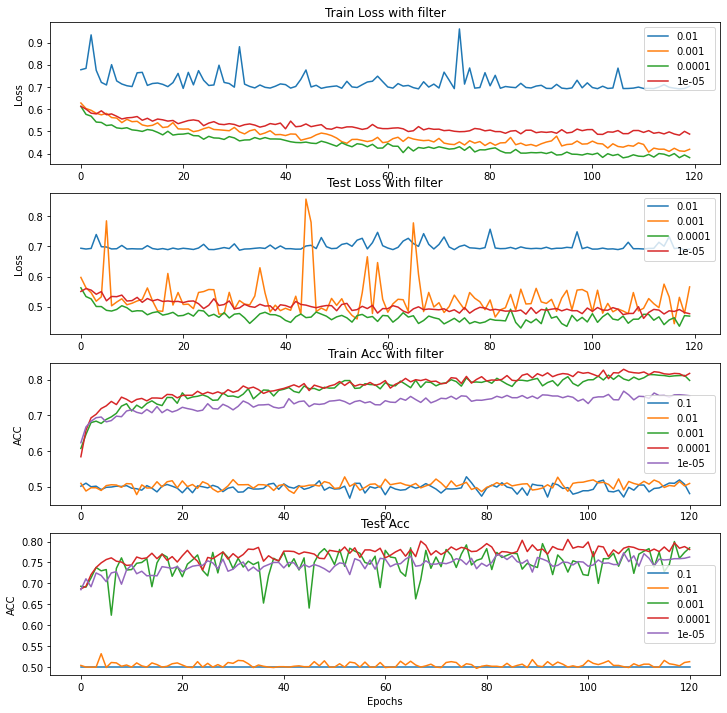

In [ ]:
labels=[str(i) for i in learning_rate_]
fig, (ax1,ax2,ax3,ax4) = plt.subplots(4, figsize=(12,12))
for i in range(1,len(results_loss_train)):
  ax1.plot(results_loss_train[i][1:],label=labels[i])
  ax1.legend()
  ax1.set_title('Train Loss with filter')
  ax1.set_ylabel('Loss')

for i in range(1,len(results_loss_test)):
  ax2.plot(results_loss_test[i][1:],label=labels[i])
  ax2.legend()
  ax2.set_title('Test Loss with filter')

  ax2.set_ylabel('Loss')

for i in range(len(results_acc_train)):
  ax3.plot(results_acc_train[i],label=labels[i])
  ax3.legend()
  ax3.set_title('Train Acc with filter')

  ax3.set_ylabel('ACC')

for i in range(len(results_acc_test)):
  ax4.plot(results_acc_test[i],label=labels[i])
  ax4.legend()
  ax4.set_title('Test Acc')
  ax4.set_xlabel('Epochs')
  ax4.set_ylabel('ACC')



* Le graphique 1 représente l'aug de l'accuracy sur le train, le graphique 2 l'accuracy sur l'echantillon de validation. Le graphique 3 et 4, la diminution de la loss sur le train et l'echantillon de  validation. les courbes correspondent aux différentes valeurs de la learning rate.
* Attention au code couleur, les deux premiers graphiques sont représentés, sans la lr=0.1
* Les résultats avec lr=0.1 sont si mauvais qu'on ne les plot pas pour la loss
* On voit clairement que la courbe rouge et verte permettent d'obtenir les meilleurs résultats(lr=0.001 et lr=0.0001)
* C'est généralement la learning rate de 0.0001 qui permet d'obtenir le meilleur score. On peut voir ca en regardant la loss sur l'échantillon de validation qui est toujours inférieure aux autres. 
* On constate également que les différentes valeurs se stabilise vers les 60 epochs. En pratique on ferait donc au maximum 60 epochs avec cette data augmentation. 
* Avec 120 epochs on cours le risque de commencer à overfit, c'est à dire à continuer à améliorer le score sur l'échantillon de train mais plus sur l'échantillon de test. 
* Le modèle final sera donc lr=0.0001 avec 60 epochs. 
* Le choix du modèle doit se faire sur notre échantillon de validation uniquement, car il nous donne la meilleur information sur la capacité de notre modèle à se généraliser sur de nouvelles données. 

In [ ]:
cnn_model = build_CNN_from_pretrained("pretrained_model.h5",output_dim=2,layer_pop=2,lr=0.001)
cnn_model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_15 (Conv2D)           (None, 30, 30, 32)        896       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 15, 15, 32)        0         
_________________________________________________________________
dropout_20 (Dropout)         (None, 15, 15, 32)        0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 13, 13, 64)        18496     
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 6, 6, 64)          0         
_________________________________________________________________
dropout_21 (Dropout)         (None, 6, 6, 64)          0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 4, 4, 64)         

In [ ]:
 # On entraine un modèle en modifiant les deux dernieres couches (layer_pop=2)
 train=True
 if train==True: 
  learning_rate_=[0.1,0.01,0.001,0.0001,0.00001]
  epochs=121
  results_acc_train2=[]
  results_acc_test2=[]
  results_loss_train2=[]
  results_loss_test2=[]

  count=1
  for learn_rate in learning_rate_:
    start = time.time()
    
    model3=build_CNN_from_pretrained("pretrained_model.h5",output_dim=2,layer_pop=2,lr=learn_rate)

    history3=model3.fit(
            train_flow2,
            epochs=epochs,
            validation_data=valid_flow2,
            verbose=0)
    results_acc_train2.append(history3.history['accuracy'])
    results_acc_test2.append(history3.history['val_accuracy'])
    results_loss_train2.append(history3.history['loss'])
    results_loss_test2.append(history3.history['val_loss'])
    end = time.time()

    print('{}/{}'.format(count,len(learning_rate_)))
    print('Learning rate :{}'.format(learn_rate))
    print('Time : {}s'.format(round(end - start,2)))
    print("Train Accuracy :",model3.evaluate_generator(train_flow2,20)[1])
    print("Validation Accuracy :",model3.evaluate_generator(valid_flow2,20)[1])
    print('\n')
    count+=1

1/5
Learning rate :0.1
Time : 311.01s
Train Accuracy : 0.5099999904632568
Validation Accuracy : 0.5475000143051147


2/5
Learning rate :0.01
Time : 310.71s
Train Accuracy : 0.48249998688697815
Validation Accuracy : 0.5024999976158142


3/5
Learning rate :0.001
Time : 310.64s
Train Accuracy : 0.8774999976158142
Validation Accuracy : 0.7900000214576721


4/5
Learning rate :0.0001
Time : 310.72s
Train Accuracy : 0.8700000047683716
Validation Accuracy : 0.7774999737739563


5/5
Learning rate :1e-05
Time : 310.85s
Train Accuracy : 0.7574999928474426
Validation Accuracy : 0.7724999785423279




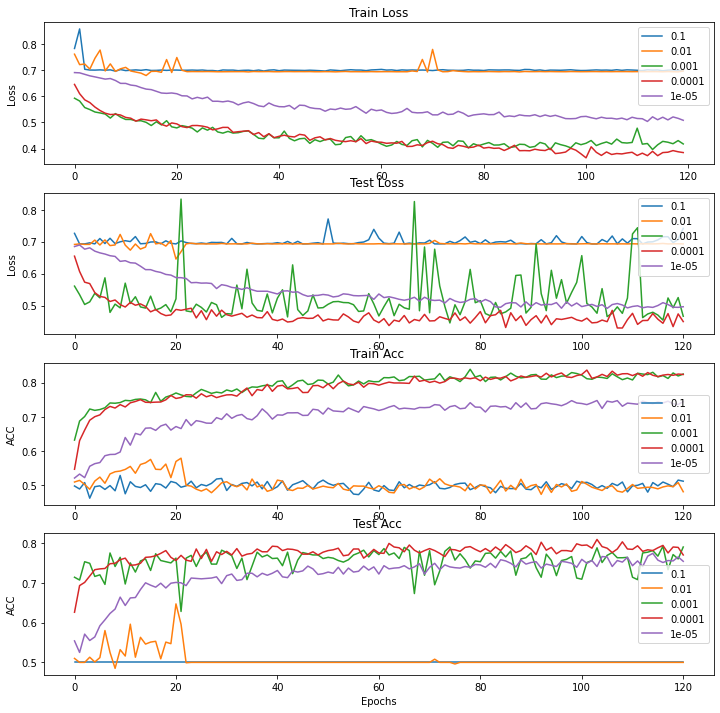

In [ ]:
labels=[str(i) for i in learning_rate_]
fig, (ax1,ax2,ax3,ax4) = plt.subplots(4, figsize=(12,12))
for i in range(len(results_loss_train2)):
  ax1.plot(results_loss_train2[i][1:],label=labels[i])
  ax1.legend()
  ax1.set_title('Train Loss')
  ax1.set_ylabel('Loss')

for i in range(len(results_loss_test2)):
  ax2.plot(results_loss_test2[i],label=labels[i])
  ax2.legend()
  ax2.set_title('Test Loss ')

  ax2.set_ylabel('Loss')

for i in range(len(results_acc_train2)):
  ax3.plot(results_acc_train2[i],label=labels[i])
  ax3.legend()
  ax3.set_title('Train Acc ')

  ax3.set_ylabel('ACC')

for i in range(len(results_acc_test2)):
  ax4.plot(results_acc_test2[i],label=labels[i])
  ax4.legend()
  ax4.set_title('Test Acc ')
  ax4.set_xlabel('Epochs')
  ax4.set_ylabel('ACC')



* On laisse cette fois lr=0.1 car ces valeurs n'explose pas ce qui été le cas dans la modélisation précédente. 
* On constate comme précédemment, qu'il est inutile de faire 120 Epochs, on préfèrera 50 epochs pour le modèle final. 
* On voit enfin que c'est lr = 0.0001 qui permet d'obtenir le meilleur score en se situant sous la courbe verte dans le graphique "Test Loss". On obtient donc une loss de validation inférieure avec cette learning rate. 
* On constate enfin qu'il n'existe pas un grande différence dans les scores entre fine tune 1 ou 2 couches.

### Q5

#### Avec et sans Data augmentation

In [ ]:
model_aug = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001,dropout=True)
log_dir_aug=os.path.join("logs/aug/aug_True", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_aug = TensorBoard(log_dir=log_dir_aug)
history=model_aug.fit(
      train_flow2, # On utilise la data augmentation
      epochs=121, 
      validation_data=valid_flow2,
      callbacks=[tensorboard_aug], 
      verbose=0)


model_nonaug = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001,dropout=True)
log_dir_nonaug=os.path.join("logs/aug/aug_False", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_noaug = TensorBoard(log_dir=log_dir_nonaug)

history=model_nonaug.fit(
      train_flow, # On utilise pas la data augmentation
      epochs=121, # 50 epochs 
      validation_data=valid_flow,
      callbacks=[tensorboard_noaug],
      verbose=0)


In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/aug

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

* On voit clairement un énorme overfitting quand on ne met pas de data augmentation. 
* En effet la courbe rouge qui correspond au cas ou on a pas mis de data augmentation, obtient toujours le meilleur score. Seulement ce score est obtenu sur l'échantillon de train. Quand on le comparer au score sur l'échantillon de test, (courbe bleu claire) on voit que l'écart est très important.
* On voit donc qude la dataaugmentation permet d'eviter l'overfitting avec le nombre d'epochs, mais également d'augementer le score de classification, comme c'est le cas ici. 
* On fera de la data augmentation dans le prochaines exemples. 

#### Avec et sans pretraining

In [ ]:
model_ = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001,dropout=True)
log_dir_noptrain=os.path.join("logs/model/Pretrain_False", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_noptrain = TensorBoard(log_dir=log_dir_noptrain)
history=model_.fit(
      train_flow2, # On utilise la data augmentation
      epochs=121, 
      validation_data=valid_flow2,
      callbacks=[tensorboard_noptrain], 
      verbose=0)


model_pretrain_1 = build_CNN_from_pretrained("pretrained_model.h5",output_dim=2,layer_pop=1,lr=0.0001) # 1 layer pop
log_dir_pretrain_1=os.path.join("logs/model/Pretrain_True_1", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_pretrain_1 = TensorBoard(log_dir=log_dir_pretrain_1)
history=model_pretrain_1.fit(
      train_flow2, # On utilise la data augmentation
      epochs=121, 
      validation_data=valid_flow2,
      callbacks=[tensorboard_pretrain_1],
      verbose=0)

model_pretrain_2 = build_CNN_from_pretrained("pretrained_model.h5",output_dim=2,layer_pop=2,lr=0.0001) # 2 layer pop
log_dir_pretrain_2=os.path.join("logs/model/Pretrain_True_2", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_pretrain_2 = TensorBoard(log_dir=log_dir_pretrain_2)
history=model_pretrain_2.fit(
      train_flow2, # On utilise la data augmentation
      epochs=121, 
      validation_data=valid_flow2,
      callbacks=[tensorboard_pretrain_2],
      verbose=0)



In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/model

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

* Nous avons ici trois courbre, la verte et la bleu claire sont les résultats obtenus après le fine tuning sur le modèle déjà entrain, la derniere correspondaux résultat sur le modèle que nous avons construit. Nous n'affichons ici que les résultats sur l'échantillon de validation.
* On voit clairement qu'utiliser le modèle déjà entrainé permet d'augmenter les résultats que que soit l'epoch choisit.
* Nous avons pris délibérément un nombre d'epochs assez important, cela afin d'observer la tendance. On voit qu'ici 50 epochs pouvait suffir car après ca la loss et l'accuracy semble stagner. 
* On ne va pas afficher les courbes de l'échantillon train pour plus de lisibilité, mais les résultats sur le train sont sans surprise, les courbes diminuent à mesure que le nombre d'épochs augmente pour la loss. Et augmente pour l'accuracy. 

#### Avec et sans dropout

In [ ]:
model4 = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001,dropout=True)
model5 = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001,dropout=False)
model5.summary()

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_33 (Conv2D)           (None, 30, 30, 32)        896       
_________________________________________________________________
max_pooling2d_33 (MaxPooling (None, 15, 15, 32)        0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 13, 13, 64)        18496     
_________________________________________________________________
max_pooling2d_34 (MaxPooling (None, 6, 6, 64)          0         
_________________________________________________________________
conv2d_35 (Conv2D)           (None, 4, 4, 64)          36928     
_________________________________________________________________
max_pooling2d_35 (MaxPooling (None, 2, 2, 64)          0         
_________________________________________________________________
flatten_11 (Flatten)         (None, 256)             

In [ ]:
model4 = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001,dropout=True) # Modèle sans pré-traine
log_dir4=os.path.join("logs/drop/Dropout_True", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard4 = TensorBoard(log_dir=log_dir4)
history4=model4.fit(
      train_flow2, # On utilise la data augmentation
      epochs=121, # 
      validation_data=valid_flow2,callbacks=[tensorboard4],
      verbose=0)


model5 = build_CNN(input_dim=(32, 32, 3),output_dim=2,lr=0.001,dropout=False) # Modèle sans pré-traine
log_dir5=os.path.join("logs/drop/Dropout_False", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard5 = TensorBoard(log_dir=log_dir5)
history5=model5.fit(
      train_flow2, # On utilise la data augmentation
      epochs=121, # 
      validation_data=valid_flow2,callbacks=[tensorboard5],
      verbose=0)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/drop

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

* la courbe bleu claire et rouge représente le cas ou on a pas mis le dropout sur l'echantillon de validation et de train respectivement.
* On voit un gros écart entre ces deux courbes, ce qui nous indique clairement qu'on overfit notre modèle si on ne met pas le dropout. 